# Task 1: Filters Visualization
## 1.1 - Load VGG16
We are loading a (pretrained) VGG16 via torchvision

In [1]:
import numpy as np
import os
import torch
from torch.optim import Adam
from torchvision import models
from filters_visualization import visualise_layer_filter, visualise_layer_filter_2, deep_dream
from aux_ops import preprocess_image, recreate_image, save_image
import matplotlib.pyplot as plt

# Select the device to work on.
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print('Using:', device)

model = models.vgg16(weights='DEFAULT')

c:\Users\Ilir\anaconda3\envs\gen-ai\Lib\site-packages\torchvision\io\image.py:13: UserWarning: Failed to load image Python extension: '[WinError 127] Die angegebene Prozedur wurde nicht gefunden'If you don't plan on using image functionality from `torchvision.io`, you can ignore this warning. Otherwise, there might be something wrong with your environment. Did you have `libjpeg` or `libpng` installed before building `torchvision` from source?
  warn(


device:  cuda:0
Using: cuda:0


## 1.2 - Optimize input image


rand_img shape  (224, 224, 3)


c:\Users\Ilir\Desktop\LMU\SS24\Gen AI\generative-ai-image-synthesis\exercise_5\filters_visualization.py:35: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  processed_image = torch.tensor(processed_image, device=device).float()


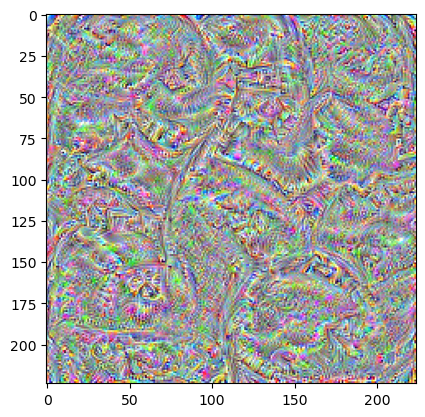

In [2]:
# TODO: add your code here
model.eval()
layer_nmbr = 28
filter_nmbr = 228

# Fix model weights
for param in model.parameters():
    param.requires_grad = False

model.to(device)
optimized_image = visualise_layer_filter(model.features, layer_nmbr=layer_nmbr, filter_nmbr=filter_nmbr)

plt.imshow(optimized_image)
plt.show()


## Task 1.3 - Visualize a random filter.

rand_img shape  (224, 224, 3)


c:\Users\Ilir\Desktop\LMU\SS24\Gen AI\generative-ai-image-synthesis\exercise_5\filters_visualization.py:35: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  processed_image = torch.tensor(processed_image, device=device).float()


rand_img shape  (224, 224, 3)
rand_img shape  (224, 224, 3)
rand_img shape  (224, 224, 3)
rand_img shape  (224, 224, 3)


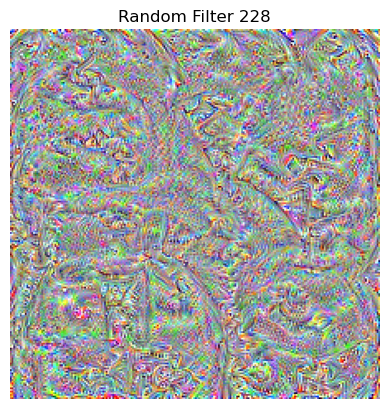

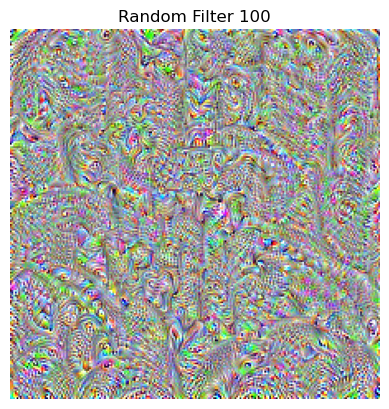

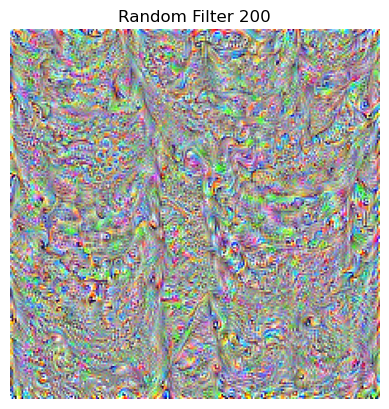

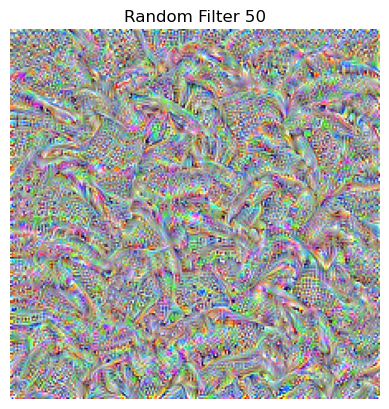

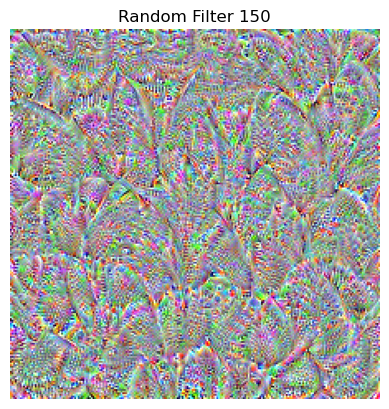

In [3]:
# TODO: add your code here
filter_nmbrs = [228, 100, 200, 50, 150]  # Random filters for visualization
for filter_nmbr in filter_nmbrs:
    optimized_image = visualise_layer_filter(model.features, layer_nmbr=layer_nmbr, filter_nmbr=filter_nmbr)

    # Display the optimized image
    plt.figure()
    plt.title(f'Random Filter {filter_nmbr}')
    plt.imshow(optimized_image)
    plt.axis('off')
plt.show()

## Task 1.4 - Visualize filters at different layers.

rand_img shape  (224, 224, 3)
rand_img shape  (224, 224, 3)
rand_img shape  (224, 224, 3)
rand_img shape  (224, 224, 3)
rand_img shape  (224, 224, 3)
rand_img shape  (224, 224, 3)
rand_img shape  (224, 224, 3)
rand_img shape  (224, 224, 3)
rand_img shape  (224, 224, 3)
rand_img shape  (224, 224, 3)
rand_img shape  (224, 224, 3)
rand_img shape  (224, 224, 3)
rand_img shape  (224, 224, 3)
rand_img shape  (224, 224, 3)
rand_img shape  (224, 224, 3)
rand_img shape  (224, 224, 3)
rand_img shape  (224, 224, 3)
rand_img shape  (224, 224, 3)
rand_img shape  (224, 224, 3)
rand_img shape  (224, 224, 3)
rand_img shape  (224, 224, 3)
rand_img shape  (224, 224, 3)
rand_img shape  (224, 224, 3)
rand_img shape  (224, 224, 3)
rand_img shape  (224, 224, 3)


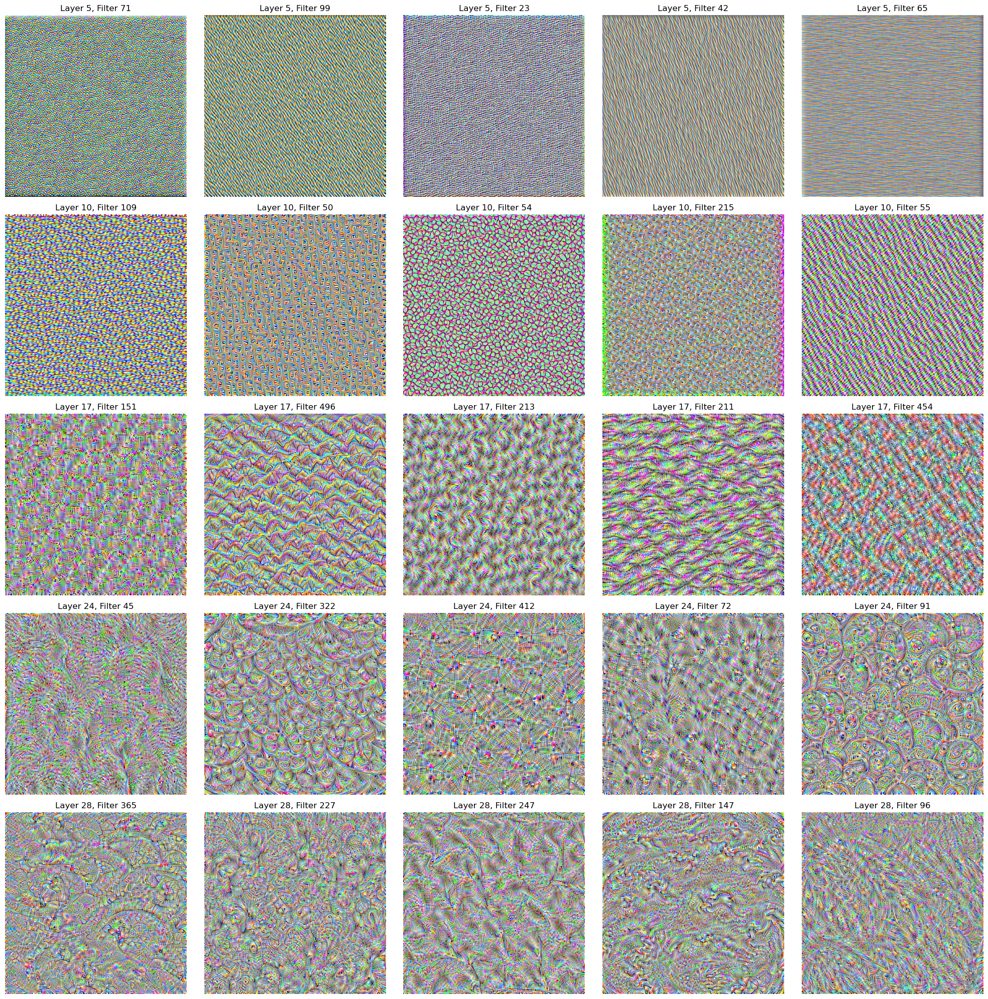

In [4]:
# TODO: add your code here
layer_nmbers = [5, 10, 17, 24, 28]  # Different layers for visualization
filter_nmbrs = [28, 100, 200, 50, 150]  # Random filters for visualization

    # Visualize each filter at each layer
fig, axs = plt.subplots(len(layer_nmbers), 5, figsize=(20, 20))
for i, layer_nmbr in enumerate(layer_nmbers):
    # Get the number of filters in the current layer
    num_filters = model.features[layer_nmbr].out_channels
    # Choose random filter numbers within the valid range
    filter_nmbrs = np.random.choice(num_filters, size=5, replace=False)
    for j, filter_nmbr in enumerate(filter_nmbrs):
        optimized_image = visualise_layer_filter(model.features, layer_nmbr=layer_nmbr, filter_nmbr=filter_nmbr)

        # Display the optimized image
        axs[i, j].imshow(optimized_image)
        axs[i, j].set_title(f'Layer {layer_nmbr}, Filter {filter_nmbr}')
        axs[i, j].axis('off')

plt.tight_layout()
plt.show()

## Task 1.5 - Hyperparameter tuning.


rand_img shape  (224, 224, 3)


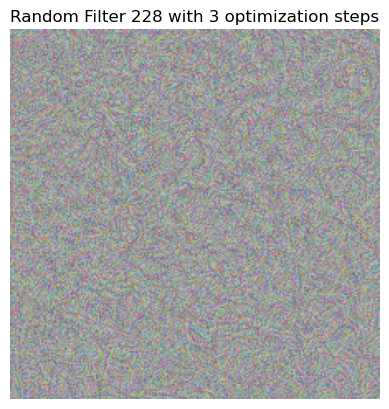

rand_img shape  (224, 224, 3)


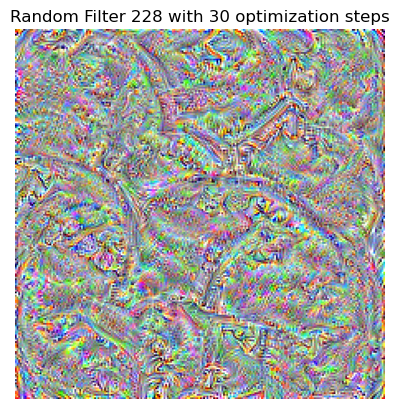

rand_img shape  (224, 224, 3)


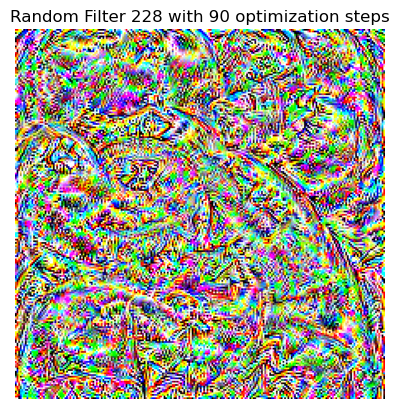

rand_img shape  (224, 224, 3)


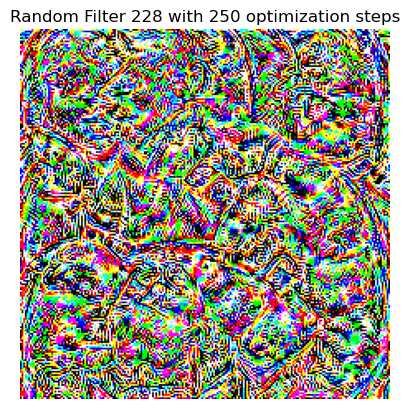

In [5]:
# TODO: add your code here
layer_nmbr = 28
filter_nmbr = 228
optim_steps = 3
optimized_image = visualise_layer_filter(model.features, layer_nmbr=layer_nmbr, filter_nmbr=filter_nmbr, num_optim_steps=optim_steps)

# Display the optimized image
plt.figure()
plt.title(f'Random Filter {filter_nmbr} with {optim_steps} optimization steps')
plt.imshow(optimized_image)
plt.axis('off')
plt.show()

layer_nmbr = 28
filter_nmbr = 228
optim_steps = 30
optimized_image = visualise_layer_filter(model.features, layer_nmbr=layer_nmbr, filter_nmbr=filter_nmbr, num_optim_steps=optim_steps)

# Display the optimized image
plt.figure()
plt.title(f'Random Filter {filter_nmbr} with {optim_steps} optimization steps')
plt.imshow(optimized_image)
plt.axis('off')
plt.show()

layer_nmbr = 28
filter_nmbr = 228
optim_steps = 90
optimized_image = visualise_layer_filter(model.features, layer_nmbr=layer_nmbr, filter_nmbr=filter_nmbr, num_optim_steps=optim_steps)

# Display the optimized image
plt.figure()
plt.title(f'Random Filter {filter_nmbr} with {optim_steps} optimization steps')
plt.imshow(optimized_image)
plt.axis('off')
plt.show()

layer_nmbr = 28
filter_nmbr = 228
optim_steps = 250
optimized_image = visualise_layer_filter(model.features, layer_nmbr=layer_nmbr, filter_nmbr=filter_nmbr, num_optim_steps=optim_steps)

# Display the optimized image
plt.figure()
plt.title(f'Random Filter {filter_nmbr} with {optim_steps} optimization steps')
plt.imshow(optimized_image)
plt.axis('off')
plt.show()

## Task 1.6 - Pretrained weights.


rand_img shape  (224, 224, 3)


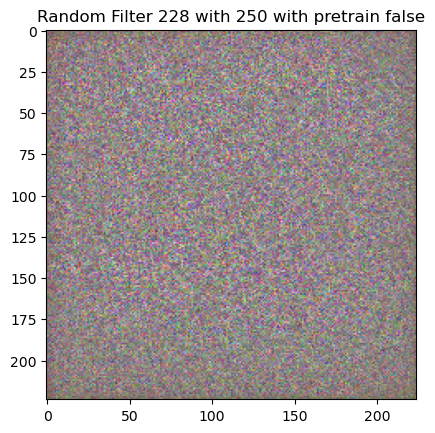

In [6]:
# TODO: add your code here
model = models.vgg16()
model.to(device)
model.eval()
layer_nmbr = 28
filter_nmbr = 228

# Fix model weights
for param in model.parameters():
    param.requires_grad = False

model.cuda()
optimized_image = visualise_layer_filter(model.features, layer_nmbr=layer_nmbr, filter_nmbr=filter_nmbr)

plt.title(f'Random Filter {filter_nmbr} with {optim_steps} with pretrain false')
plt.imshow(optimized_image)
plt.show()

rand_img shape  (224, 224, 3)


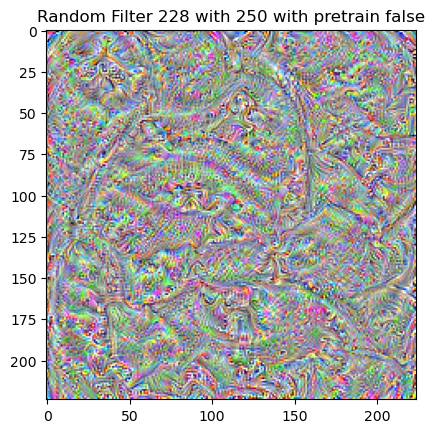

In [7]:
model = models.vgg16(weights='DEFAULT')
model.to(device)
model.eval()
layer_nmbr = 28
filter_nmbr = 228

# Fix model weights
for param in model.parameters():
    param.requires_grad = False

model.cuda()
optimized_image = visualise_layer_filter(model.features, layer_nmbr=layer_nmbr, filter_nmbr=filter_nmbr)

plt.title(f'Random Filter {filter_nmbr} with {optim_steps} with pretrain false')
plt.imshow(optimized_image)
plt.show()

# Task 2: Deep Dream

## Task 1.1 Most activated filters for every image

c:\Users\Ilir\anaconda3\envs\gen-ai\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Ilir\anaconda3\envs\gen-ai\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


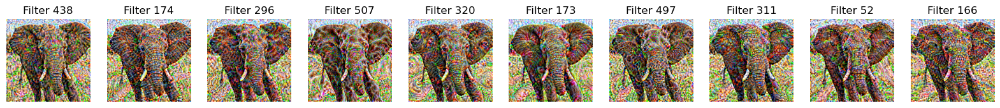

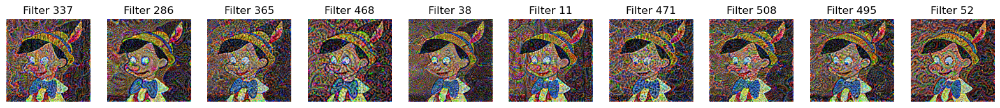

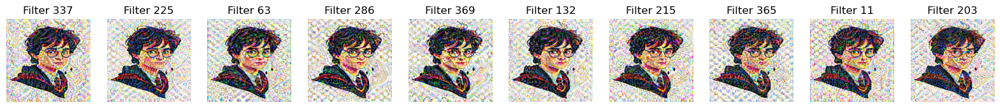

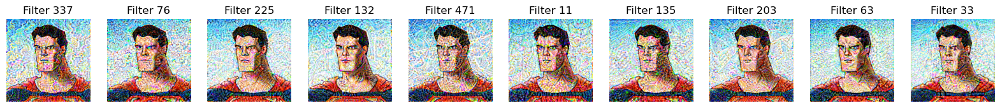

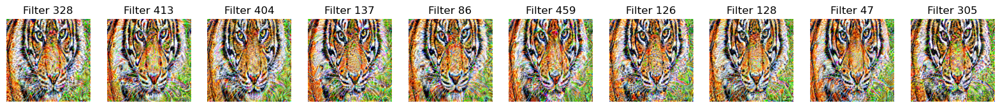

In [8]:
# TODO: add your code here
from PIL import Image

layer_nmbr = 28  # Example layer
image_paths = ["images/elephant.jpg", "images/pinocchio.jpg", "images/potter.jpg", "images/superman.jpg", "images/tiger.jpg"]

model = models.vgg16(pretrained=True).features.to(device)
model.eval()

for param in model.parameters():
    param.requires_grad = False

for img_path in image_paths:
    img = Image.open(img_path)
    img = np.array(img)
    img_tensor = preprocess_image(img)
    img_tensor = img_tensor.to(device)
    x = img_tensor
    for index, layer in enumerate(model):
        x = layer(x)
        if index == layer_nmbr:
            break

    conv_output = x[0]

    # Find the 10 most activated filters
    mean_activations = torch.mean(conv_output, dim=[1, 2])
    top_10_filters = torch.argsort(mean_activations, descending=True)[:10]

    # Collect optimized images
    optimized_images = []
    for filter_nmbr in top_10_filters:
        optimized_image = visualise_layer_filter_2(model,layer_nmbr=layer_nmbr,filter_nmbr=filter_nmbr.item(),init_img=img_tensor,num_optim_steps=50,tv_weight=1e-6)
        optimized_images.append(optimized_image)

    # Plot the optimized images together
    fig, axs = plt.subplots(1, 10, figsize=(20, 2))
    for ax, img, filter_nmbr in zip(axs, optimized_images, top_10_filters):
        ax.imshow(img)
        ax.set_title(f"Filter {filter_nmbr.item()}")
        ax.axis('off')
    plt.show()
    

## Task 1.2 Total variation loss.

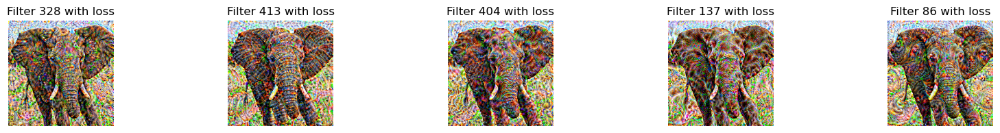

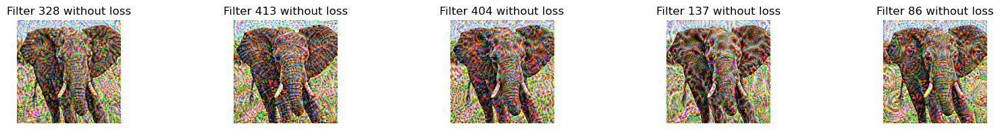

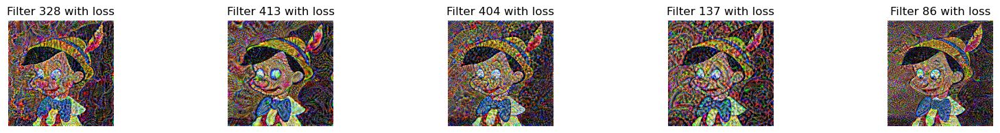

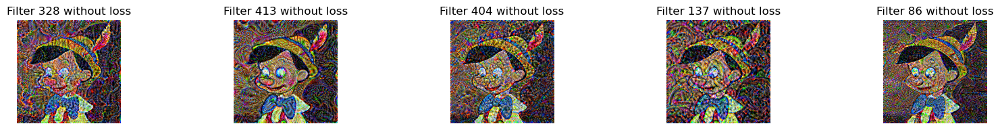

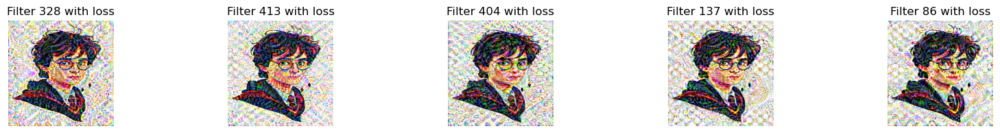

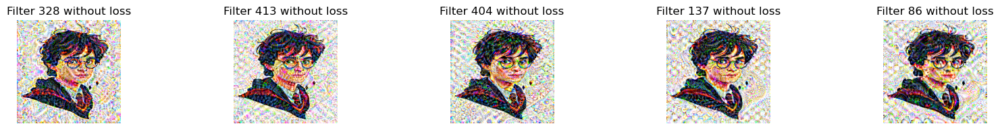

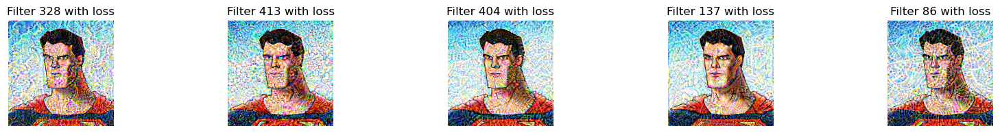

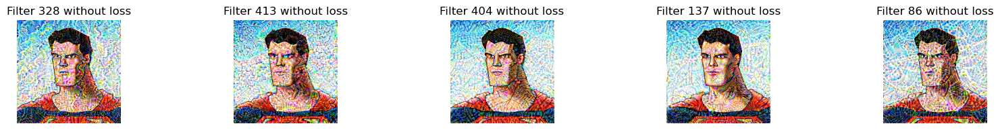

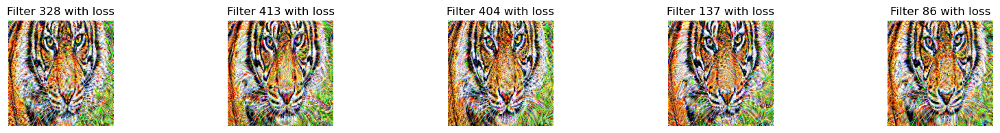

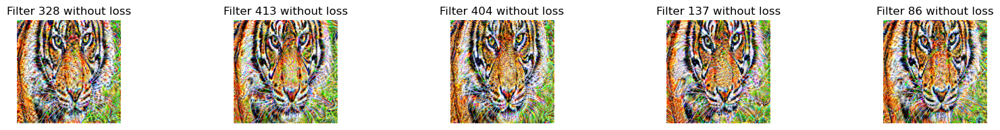

In [9]:
# TODO: add your code here
model = models.vgg16(weights='DEFAULT').features.to(device)
model.eval()

for param in model.parameters():
    param.requires_grad = False

for img_path in image_paths:
    img = Image.open(img_path)
    img = np.array(img)
    img_tensor = preprocess_image(img)
    img_tensor = img_tensor.to(device)
    x = img_tensor
    for index, layer in enumerate(model):
        x = layer(x)
        if index == layer_nmbr:
            break

    conv_output = x[0]

    # Find the 10 most activated filters
    mean_activations = torch.mean(conv_output, dim=[1, 2])
    top_5_filters = torch.argsort(mean_activations, descending=True)[:5]

    # Collect optimized images
    optimized_images = []
    for filter_nmbr in top_5_filters:
        optimized_image = visualise_layer_filter_2(model,layer_nmbr=layer_nmbr,filter_nmbr=filter_nmbr.item(),init_img=img_tensor,num_optim_steps=50,tv_weight=1e-6)
        optimized_images.append(optimized_image)

    # Plot the optimized images together
    fig, axs = plt.subplots(1, 5, figsize=(20, 2))
    for ax, img, filter_nmbr in zip(axs, optimized_images, top_10_filters):
        ax.imshow(img)
        ax.set_title(f"Filter {filter_nmbr.item()} with loss")
        ax.axis('off')
    plt.show()

    optimized_images = []
    for filter_nmbr in top_5_filters:
        optimized_image = visualise_layer_filter_2(model,layer_nmbr=layer_nmbr,filter_nmbr=filter_nmbr.item(),init_img=img_tensor,num_optim_steps=50,tv_weight=0)
        optimized_images.append(optimized_image)

    # Plot the optimized images together
    fig, axs = plt.subplots(1, 5, figsize=(20, 2))
    for ax, img, filter_nmbr in zip(axs, optimized_images, top_10_filters):
        ax.imshow(img)
        ax.set_title(f"Filter {filter_nmbr.item()} without loss")
        ax.axis('off')

    plt.show()

## Task 1.3 Deep dream.

In [10]:
# TODO: add your code here
import random
from PIL import Image


image_path = "images/elephant.jpg"
num_layers = 6
total_layers = len(models.vgg16(weights='DEFAULT').features)
layers_to_optimize = random.sample(range(total_layers), num_layers)
model = models.vgg16(weights='DEFAULT').features.to(device)

model.eval()
for param in model.parameters():
    param.requires_grad = False

img = Image.open(image_path)
img = np.array(img)
img_tensor = preprocess_image(img)
img_tensor = img_tensor.to(device)

# Apply Deep Dream
layers_to_optimize= [4,5,6]
print('Layers to optimize: ', layers_to_optimize)
deep_dream_image = deep_dream(model, init_img=img_tensor, layers=layers_to_optimize, num_optim_steps=200, lr=0.05, tv_weight=1e-4)

# Display the final Deep Dream image
plt.imshow(deep_dream_image)
plt.title("Deep Dream Image")
plt.axis('off')
plt.show()


Layers to optimize:  [4, 5, 6]
inside l2 norm
inside l2 norm
inside l2 norm


RuntimeError: one of the variables needed for gradient computation has been modified by an inplace operation: [torch.cuda.FloatTensor [1, 128, 112, 112]], which is output 0 of ReluBackward0, is at version 1; expected version 0 instead. Hint: enable anomaly detection to find the operation that failed to compute its gradient, with torch.autograd.set_detect_anomaly(True).